In [15]:
from matplotlib import pyplot
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

In [5]:
cd ~/ex

/home/xieyufeng/ex


In [6]:
batch_info = 'data/'+'scirep'+'/batch_info.txt'
batch = pd.read_table(batch_info,sep='\t',index_col=0)

In [7]:
b = batch[batch.index=='Sample_1S3']

In [8]:
b.columns[1]

'library prepration day'

In [ ]:
'output/scirep/count_matrix/domains_combined.txt'

In [36]:
original_mx_file = 'output/'+'scirep'+'/count_matrix/'+'domains_combined'+'.txt'
original_mx = pd.read_table(original_mx_file,index_col=0)

In [38]:
original_mx

,Sample_1S3,Sample_1S6,Sample_1S9,Sample_1S12,Sample_1S15,Sample_1S18,Sample_1S21,Sample_1S24,Sample_4S2,Sample_4S5,...,Sample_4S16,Sample_4S19,Sample_4S22,Sample_4S25,Sample_N49,Sample_Pan05,Sample_Pan06,Sample_PC6,Sample_PC12,Sample_PC26
feature,,,,,,,,,,,,,,,,,,,,,
hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-7a-2-3p|hsa-let-7a-2-3p|0|22,9,14,3,1,6,1,6,8,14,6,...,18,3,6,5,11,1,1,7,12,10
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p|hsa-let-7a-3p|0|21,283,503,214,153,451,165,435,564,659,421,...,733,185,224,685,837,186,166,294,647,498
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p|hsa-let-7a-5p|0|22,2460,6617,2140,1718,3872,1757,4559,6526,6476,7779,...,11828,1815,2512,6301,7514,1539,1457,2386,5836,4888
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p|hsa-let-7b-3p|0|22,230,340,147,219,207,122,189,278,335,458,...,504,174,278,308,367,124,128,265,395,219
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p|hsa-let-7b-5p|0|22,56569,55954,51215,55669,23908,25192,32174,58741,53344,45357,...,63867,37678,43107,37548,61921,16446,16151,59529,59295,57452
hsa-let-7c-3p|miRNA|hsa-let-7c-3p|hsa-let-7c-3p|hsa-let-7c-3p|0|22,29,53,32,20,29,12,25,39,69,60,...,56,26,15,49,85,11,18,27,57,24
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p|hsa-let-7c-5p|0|22,3312,5772,2920,2358,2902,1783,3801,5788,5670,5491,...,8338,2396,3010,5211,6180,1286,1449,3413,7459,8590
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p|hsa-let-7d-3p|0|22,2222,3826,1630,1255,2124,1065,1916,2713,3902,5412,...,4763,1629,2012,2946,3725,987,944,2687,4298,1958
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p|hsa-let-7d-5p|0|22,946,1625,736,572,1082,637,1307,1933,1647,2050,...,3332,866,997,1786,2042,570,502,950,1767,1571


In [70]:
batch

,label
sample_id,
Sample_1S3,Colorectal Cancer Stage 1
Sample_1S6,Colorectal Cancer Stage 1
Sample_1S9,Colorectal Cancer Stage 1
Sample_1S12,Colorectal Cancer Stage 1
Sample_1S15,Colorectal Cancer Stage 1
Sample_1S18,Colorectal Cancer Stage 1
Sample_1S21,Colorectal Cancer Stage 1
Sample_1S24,Colorectal Cancer Stage 1
Sample_4S2,Colorectal Cancer Stage 4


In [73]:
stack[:5]

,feature,sample_id,counts,label
0,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S3,0.321928,Colorectal Cancer Stage 1
1,hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3...,Sample_1S3,-0.694173,Colorectal Cancer Stage 1
2,hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5...,Sample_1S3,-0.970976,Colorectal Cancer Stage 1
3,hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3...,Sample_1S3,-0.330643,Colorectal Cancer Stage 1
4,hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5...,Sample_1S3,0.111825,Colorectal Cancer Stage 1


In [80]:
fig,ax = plt.subplots(figsize=(7,3.5))
ax = sns.boxplot(x='label',y='counts',data=stack[:500000],fliersize=1,linewidth=0.0)
embed_pdf_figure()

In [42]:
mat=original_mx
batch=batch
log=False
batchindex=1
if log is not True:
    log_mat = np.log2(mat+1)
else:
    log_mat = mat
feature_meds = log_mat.apply(np.median,1).tolist()
for i in np.arange(len(feature_meds)):
    log_mat.iloc[i] = log_mat.iloc[i] - feature_meds[i]
mat_rle = log_mat
stack = pd.DataFrame(mat_rle.stack())
stack = stack.reset_index()
stack.rename(columns={stack.columns[2]: "counts",
                      stack.columns[1]: "sample_id"},
             inplace=True)
#stack['class'] = None

In [78]:
stack

,feature,sample_id,counts,label
0,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S3,0.321928,Colorectal Cancer Stage 1
1,hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3...,Sample_1S3,-0.694173,Colorectal Cancer Stage 1
2,hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5...,Sample_1S3,-0.970976,Colorectal Cancer Stage 1
3,hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3...,Sample_1S3,-0.330643,Colorectal Cancer Stage 1
4,hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5...,Sample_1S3,0.111825,Colorectal Cancer Stage 1
5,hsa-let-7c-3p|miRNA|hsa-let-7c-3p|hsa-let-7c-3...,Sample_1S3,-0.415037,Colorectal Cancer Stage 1
6,hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5...,Sample_1S3,-0.418354,Colorectal Cancer Stage 1
7,hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3...,Sample_1S3,-0.275098,Colorectal Cancer Stage 1
8,hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5...,Sample_1S3,-0.648055,Colorectal Cancer Stage 1
9,hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3...,Sample_1S3,-0.610053,Colorectal Cancer Stage 1


In [44]:
batch.reset_index()

,sample_id,label
0,Sample_1S3,Colorectal Cancer Stage 1
1,Sample_1S6,Colorectal Cancer Stage 1
2,Sample_1S9,Colorectal Cancer Stage 1
3,Sample_1S12,Colorectal Cancer Stage 1
4,Sample_1S15,Colorectal Cancer Stage 1
5,Sample_1S18,Colorectal Cancer Stage 1
6,Sample_1S21,Colorectal Cancer Stage 1
7,Sample_1S24,Colorectal Cancer Stage 1
8,Sample_4S2,Colorectal Cancer Stage 4
9,Sample_4S5,Colorectal Cancer Stage 4


In [45]:
pd.merge(stack, batch.reset_index(), on=['sample_id'])

,feature,sample_id,counts,label
0,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S3,0.321928,Colorectal Cancer Stage 1
1,hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3...,Sample_1S3,-0.694173,Colorectal Cancer Stage 1
2,hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5...,Sample_1S3,-0.970976,Colorectal Cancer Stage 1
3,hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3...,Sample_1S3,-0.330643,Colorectal Cancer Stage 1
4,hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5...,Sample_1S3,0.111825,Colorectal Cancer Stage 1
5,hsa-let-7c-3p|miRNA|hsa-let-7c-3p|hsa-let-7c-3...,Sample_1S3,-0.415037,Colorectal Cancer Stage 1
6,hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5...,Sample_1S3,-0.418354,Colorectal Cancer Stage 1
7,hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3...,Sample_1S3,-0.275098,Colorectal Cancer Stage 1
8,hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5...,Sample_1S3,-0.648055,Colorectal Cancer Stage 1
9,hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3...,Sample_1S3,-0.610053,Colorectal Cancer Stage 1


In [46]:
batch.sort_index(ascending=False)

,label
sample_id,
Sample_Pan06,Pancreatic Cancer
Sample_Pan05,Pancreatic Cancer
Sample_Pan04,Pancreatic Cancer
Sample_Pan03,Pancreatic Cancer
Sample_Pan02,Pancreatic Cancer
Sample_Pan01,Pancreatic Cancer
Sample_PC9,Prostate Cancer
Sample_PC8,Prostate Cancer
Sample_PC7,Prostate Cancer


In [52]:
stack

,feature,sample_id,counts,class,label
0,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S3,0.321928,None,Colorectal Cancer Stage 1
1,hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3...,Sample_1S3,-0.694173,None,Colorectal Cancer Stage 1
2,hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5...,Sample_1S3,-0.970976,None,Colorectal Cancer Stage 1
3,hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3...,Sample_1S3,-0.330643,None,Colorectal Cancer Stage 1
4,hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5...,Sample_1S3,0.111825,None,Colorectal Cancer Stage 1
5,hsa-let-7c-3p|miRNA|hsa-let-7c-3p|hsa-let-7c-3...,Sample_1S3,-0.415037,None,Colorectal Cancer Stage 1
6,hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5...,Sample_1S3,-0.418354,None,Colorectal Cancer Stage 1
7,hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3...,Sample_1S3,-0.275098,None,Colorectal Cancer Stage 1
8,hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5...,Sample_1S3,-0.648055,None,Colorectal Cancer Stage 1
9,hsa-let-7e-3p|miRNA|hsa-let-7e-3p|hsa-let-7e-3...,Sample_1S3,-0.610053,None,Colorectal Cancer Stage 1


In [56]:
batch.columnsbatch.columns[batchindex]

Index(['label'], dtype='object')

In [62]:
mat=original_mx
batch=batch
log=False
batchindex=0
if log is not True:
    log_mat = np.log2(mat+1)
else:
    log_mat = mat
feature_meds = log_mat.apply(np.median,1).tolist()
for i in np.arange(len(feature_meds)):
    log_mat.iloc[i] = log_mat.iloc[i] - feature_meds[i]
mat_rle = log_mat
stack = pd.DataFrame(mat_rle.stack())
stack = stack.reset_index()
stack.rename(columns={stack.columns[2]: "counts",
                      stack.columns[1]: "sample_id"},
             inplace=True)

if batch is not None:
    stack = pd.merge(stack, batch.reset_index(), on=['sample_id'])
    fig,ax = plt.subplots(figsize=(7,7))
    ax = sns.boxplot(x='label',y='counts',data=stack,fliersize=1,linewidth=0.5)
    std_plot(ax,batch.columns[batchindex],'RLE')
    embed_pdf_figure()
else:
    fig,ax = plt.subplots(figsize=(7,3.5))
    ax = sns.boxplot(x='sample',y='counts',data=stack,fliersize=0,linewidth=0.5)
    std_plot(ax,'sample','RLE')
    embed_pdf_figure()

In [61]:
std_plot(ax,'sample','RLE')
embed_pdf_figure()

In [139]:
fig,ax = plt.subplots(figsize=(7,7))
ax = sns.boxplot(x='class',y='counts',data=stack,fliersize=0.1,linewidth=0.5)
embed_pdf_figure()
#std_plot(ax,batch.columns[batchindex],'RLE')


In [138]:
fig
embed_pdf_figure()

In [136]:
embed_pdf_figure()

In [128]:
stack

,feature,sample,counts,class
0,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S3,0.321928,22
1,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S6,0.906891,23
2,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S9,-1.000000,23
3,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S12,-2.000000,25
4,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S15,-0.192645,26
5,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S18,-2.000000,25
6,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S21,-0.192645,26
7,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S24,0.169925,24
8,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_4S2,0.906891,22
9,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_4S5,-0.192645,23


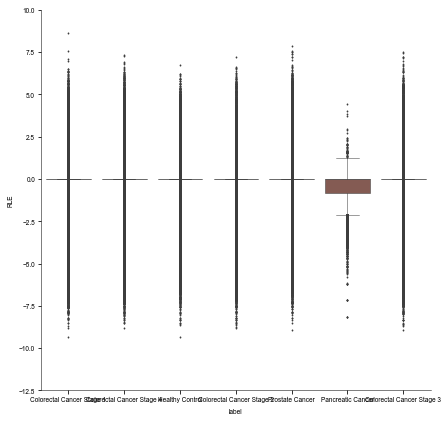

In [65]:
fig

In [68]:
def plotRLE(mat,batch,log=False,batchindex=0):
    if log is not True:
        log_mat = np.log2(mat+1)
    else:
        log_mat = mat
    feature_meds = log_mat.apply(np.median,1).tolist()
    for i in np.arange(len(feature_meds)):
        log_mat.iloc[i] = log_mat.iloc[i] - feature_meds[i]
    mat_rle = log_mat
    stack = pd.DataFrame(mat_rle.stack())
    stack = stack.reset_index()
    stack.rename(columns={stack.columns[2]: "counts",
                          stack.columns[1]: "sample_id"},
                 inplace=True)
    #stack['class'] = None
    if batch is not None:
        #for samplename in np.unique(stack['sample']):
        #    stack['class'].iloc[np.where(stack['sample'] == samplename)] \
        #    = batch[batch.index==samplename].iloc[0,batchindex]
        stack = pd.merge(stack, batch.reset_index(), on=['sample_id'])
        fig,ax = plt.subplots(figsize=(7,7))
        ax = sns.boxplot(x='label',y='counts',data=stack,fliersize=1,linewidth=0.5)
        std_plot(ax,batch.columns[batchindex],'RLE')
    else:
        fig,ax = plt.subplots(figsize=(7,3.5))
        ax = sns.boxplot(x='sample',y='counts',data=stack,fliersize=0,linewidth=0.5)
        std_plot(ax,'sample','RLE')
    #embed_pdf_figure()
plotRLE(original_mx,batch)
embed_pdf_figure()

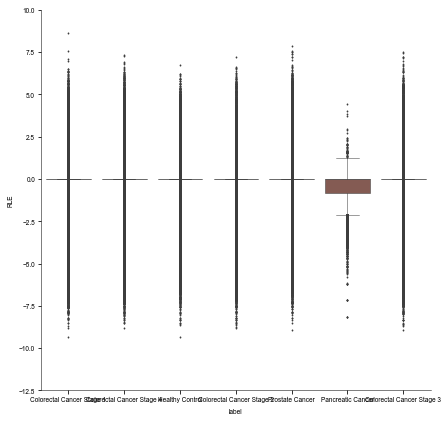

In [69]:
fig

In [91]:
batch.columns[0]

'label'

In [67]:
def embed_pdf_figure(width='640', height='480', title='Image'):
    data = BytesIO()
    plt.savefig(data, format='pdf', metadata={'Title': title})
    data = data.getvalue()
    data = 'data:application/pdf;base64,'+ str(b64encode(data), encoding='utf-8')
    display(HTML('<object width="{}" height="{}" data="{}" download="{}.pdf"></object>'.format(
        width, height, data, title)))
    plt.close()
    
from base64 import b64encode, b64decode
from io import StringIO, BytesIO

fonttitle = {'family':'Arial',
                  'weight' : 'normal', 
                  'size' : 8}
fontlabel = {'family':'Arial',
                  'weight' : 'normal', 
                  'size' : 6.5}
fontticklabel = {'family':'Arial',
                  'weight' : 'normal', 
                  'size' : 6.5}
fontlegend = {'family':'Arial',
                  'weight' : 'normal', 
              #'linewidth':0.5,
                  'size' : 6.5}
fontcbarlabel = {'family':'Arial',
                 'weight' : 'normal', 
                 #'Rotation' : 270,
                 #'labelpad' : 25,
                 'size' : 6.5}
fontcbarticklabel = {'family':'Arial',#Helvetica
                 'weight' : 'normal', 
                 'size' : 5.5}
def std_plot(ax,xlabel,ylabel,title=None,
             legendtitle=None,bbox_to_anchor=None,
             labelspacing=1.2,borderpad=0,handletextpad=0,legendsort=True,markerscale=None,
             xlim=None,ylim=None,
             xbins=None,ybins=None,
             cbar=None,cbarlabel=None,
             moveyaxis=False,sns=False,left=True):
    #plt.yticks([0,0.2,0.4,0.6,0.8,1.0],['0','0.2','0.4','0.6','0.8','1.0'])
    pyplot.draw()
    #plt.figure(linewidth=30.5)
    if xlim is not None:  
        ax.set(xlim=xlim)
    if ylim is not None:
        ax.set(ylim=ylim)
    #pyplot.draw()
    if xbins is not None:
        locator = MaxNLocator(nbins=xbins)
        locator.set_axis(ax.xaxis)
        ax.set_xticks(locator())
    if ybins is not None:
        locator = MaxNLocator(nbins=ybins)
        locator.set_axis(ax.yaxis)
        ax.set_yticks(locator())
    pyplot.draw()
    ax.set_xticks(ax.get_xticks())
    ax.set_yticks(ax.get_yticks())
    ax.set_xlabel(xlabel,fontdict = fontlabel,labelpad=5.5)
    ax.set_ylabel(ylabel,fontdict = fontlabel,labelpad=5.5)
    ax.set_xticklabels(ax.get_xticklabels(),fontticklabel)
    ax.set_yticklabels(ax.get_yticklabels(),fontticklabel)

    if moveyaxis is True:
        #fontticklabel 
        ax.spines['left'].set_position(('data',0))
    ax.spines['left'].set_visible(left)
    ax.spines['right'].set_visible(not left)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_linewidth(0.5)
    ax.spines['bottom'].set_linewidth(0.5)
    ax.spines['left'].set_linewidth(0.5)
    ax.spines['bottom'].set_color('k')
    ax.spines['left'].set_color('k')
    ax.spines['right'].set_color('k')
    
    ax.tick_params(direction='out', pad=2)
    #ax.spines['bottom']._edgecolor="#000000"
    #ax.spines['left']._edgecolor="#000000"
    if title is not None:
        ax.set_title(title,fontdict = fonttitle)
    if legendtitle is not None:
        #if legendloc is None:
        #    legendloc="best"
        legend = ax.legend(title=legendtitle,prop=fontlegend,
                      bbox_to_anchor=bbox_to_anchor,
                      labelspacing=labelspacing,borderpad=borderpad,handletextpad=handletextpad,
                      edgecolor="#000000",fancybox=False,markerscale=markerscale)
        ax.legend_.get_frame()._linewidth=0.5
        legend.get_title().set_fontweight('normal')
        legend.get_title().set_fontsize(6.5)
        if legendsort is True:
            # h: handle l:label
            h,l = ax.get_legend_handles_labels()
            l,h = zip(*sorted(zip(l,h), key=lambda t: int(t[0]))) 
            legend = ax.legend(h,l,title=legendtitle,prop=fontlegend,
                      bbox_to_anchor=bbox_to_anchor,
                      labelspacing=labelspacing,borderpad=borderpad,handletextpad=handletextpad,
                      edgecolor="#000000",fancybox=False,markerscale=markerscale)
            ax.legend_.get_frame()._linewidth=0.5
            legend.get_title().set_fontweight('normal')
            legend.get_title().set_fontsize(6.5)
        if sns is True:
            h,l = ax.get_legend_handles_labels()
            #l,h = zip(*sorted(zip(l,h), key=lambda t: int(t[0]))) 
            legend = ax.legend(h[1:],l[1:],title=legendtitle,prop=fontlegend,
                      bbox_to_anchor=bbox_to_anchor,
                      labelspacing=labelspacing,borderpad=borderpad,handletextpad=handletextpad,
                      edgecolor="#000000",fancybox=False,markerscale=markerscale)
            ax.legend_.get_frame()._linewidth=0.5
            legend.get_title().set_fontweight('normal')
            legend.get_title().set_fontsize(6.5)

    if cbar is not None:
        #locator, formatter = cbar._get_ticker_locator_formatter()
        #ticks, ticklabels, offset_string = cbar._ticker(locator, formatter)
        #cbar.ax.spines['top'].set_visible(False)
        #cbar.ax.spines['right'].set_visible(False)
        #cbar.ax.spines['bottom'].set_visible(False)
        #cbar.ax.spines['left'].set_visible(False)
        cbar.ax.tick_params(direction='out', pad=3,width=0,length=0)
        cbar.set_label(cbarlabel,fontdict = fontcbarlabel,Rotation=270,labelpad=7.5)
        cbar.ax.set_yticks(cbar.ax.get_yticks())
        cbar.ax.set_yticklabels(cbar.ax.get_yticklabels(),fontcbarticklabel)
    return ax

def gradient_func(val):
    return '<span style="background: linear-gradient(90deg, #d65f5f {0}%, transparent 0%)">{0:.3f}</span>'.format(val)

def display_dataframe(df, filename=None, encoding='utf-8', format='csv', type='button',gradientfunc=False, **kwargs):
    #display(df)
    #if isinstance(df, pd.DataFrame):
    #    display(df.style.set_caption(filename))
    #else:
    if gradientfunc == False:
        display(df.style.set_caption(filename))    
    else:
        display(df.style.format(gradient_func).set_caption(filename)) 
    if filename is None:
        filename = "dataframe"
    if format == 'csv':
        data = df.to_csv(**kwargs)
        mime_type = 'text/csv'
        filename = filename + '.csv'
    elif format == 'tsv':
        data = df.to_csv(**kwargs)
        mime_type = 'text/plain'
        filename = filename + '.txt'
    else:
        raise ValueError('unknown file format: {}'.format(format))
    data = 'data:{mime_type};base64,'.format(mime_type=mime_type) + str(b64encode(bytes(data, encoding=encoding)), encoding=encoding)
    if type == 'hyperlink':
        display(HTML('<a href=" " download={filename} target="_blank">{filename}</a >'.format(
            mime_type=mime_type, filename=filename, data=data)))
    elif type == 'button':
        button_id = 'button_{}'.format(np.random.randint(1000000000))
        display(HTML(r'<input type="button" id="{0}" value="Download">'.format(button_id)))
        display(HTML('''<script>
    document.getElementById("{button_id}").addEventListener("click", function(event){{
        var filename = "{filename}";
        var data = "{data}";
        const element = document.createElement('a');
        element.setAttribute('href', data);
        element.setAttribute('download', filename);
        element.style.display = 'none';
        document.body.appendChild(element);
        element.click();
        document.body.removeChild(element);
    }});
</script>'''.format(button_id=button_id, filename=filename, data=data)))

In [17]:
cd ~/ex

/home/xieyufeng/ex


In [18]:
original_mx_file = 'output/'+'scirep'+'/count_matrix/'+'domains_combined'+'.txt'
original_mx = pd.read_table(original_mx_file,index_col=0)

In [19]:
original_mx

,Sample_1S3,Sample_1S6,Sample_1S9,Sample_1S12,Sample_1S15,Sample_1S18,Sample_1S21,Sample_1S24,Sample_4S2,Sample_4S5,...,Sample_4S16,Sample_4S19,Sample_4S22,Sample_4S25,Sample_N49,Sample_Pan05,Sample_Pan06,Sample_PC6,Sample_PC12,Sample_PC26
feature,,,,,,,,,,,,,,,,,,,,,
hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-7a-2-3p|hsa-let-7a-2-3p|0|22,9,14,3,1,6,1,6,8,14,6,...,18,3,6,5,11,1,1,7,12,10
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p|hsa-let-7a-3p|0|21,283,503,214,153,451,165,435,564,659,421,...,733,185,224,685,837,186,166,294,647,498
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p|hsa-let-7a-5p|0|22,2460,6617,2140,1718,3872,1757,4559,6526,6476,7779,...,11828,1815,2512,6301,7514,1539,1457,2386,5836,4888
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p|hsa-let-7b-3p|0|22,230,340,147,219,207,122,189,278,335,458,...,504,174,278,308,367,124,128,265,395,219
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p|hsa-let-7b-5p|0|22,56569,55954,51215,55669,23908,25192,32174,58741,53344,45357,...,63867,37678,43107,37548,61921,16446,16151,59529,59295,57452
hsa-let-7c-3p|miRNA|hsa-let-7c-3p|hsa-let-7c-3p|hsa-let-7c-3p|0|22,29,53,32,20,29,12,25,39,69,60,...,56,26,15,49,85,11,18,27,57,24
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p|hsa-let-7c-5p|0|22,3312,5772,2920,2358,2902,1783,3801,5788,5670,5491,...,8338,2396,3010,5211,6180,1286,1449,3413,7459,8590
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p|hsa-let-7d-3p|0|22,2222,3826,1630,1255,2124,1065,1916,2713,3902,5412,...,4763,1629,2012,2946,3725,987,944,2687,4298,1958
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p|hsa-let-7d-5p|0|22,946,1625,736,572,1082,637,1307,1933,1647,2050,...,3332,866,997,1786,2042,570,502,950,1767,1571


In [20]:
mat = original_mx
log_mat = np.log2(mat+1)
feature_meds = log_mat.apply(np.median,1).tolist()
for i in np.arange(len(feature_meds)):
    log_mat.iloc[i] = log_mat.iloc[i] - feature_meds[i]
mat_rle = log_mat
mat_rle

,Sample_1S3,Sample_1S6,Sample_1S9,Sample_1S12,Sample_1S15,Sample_1S18,Sample_1S21,Sample_1S24,Sample_4S2,Sample_4S5,...,Sample_4S16,Sample_4S19,Sample_4S22,Sample_4S25,Sample_N49,Sample_Pan05,Sample_Pan06,Sample_PC6,Sample_PC12,Sample_PC26
feature,,,,,,,,,,,,,,,,,,,,,
hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-7a-2-3p|hsa-let-7a-2-3p|0|22,0.321928,0.906891,-1.000000,-2.000000,-0.192645,-2.000000,-0.192645,0.169925,0.906891,-0.192645,...,1.247928,-1.000000,-0.192645,-0.415037,0.584963,-2.000000,-2.000000,0.000000,0.700440,0.459432
hsa-let-7a-3p|miRNA|hsa-let-7a-3p|hsa-let-7a-3p|hsa-let-7a-3p|0|21,-0.694173,0.133360,-1.095727,-1.577134,-0.023741,-1.468881,-0.075736,0.298187,0.522402,-0.122821,...,0.675716,-1.304761,-1.030139,0.578145,0.866886,-1.297026,-1.460216,-0.639349,0.495930,0.118976
hsa-let-7a-5p|miRNA|hsa-let-7a-5p|hsa-let-7a-5p|hsa-let-7a-5p|0|22,-0.970976,0.456174,-1.171936,-1.488651,-0.316769,-1.456286,-0.081187,0.436199,0.425105,0.689549,...,1.294035,-1.409457,-0.940810,0.385589,0.639552,-1.647291,-1.726230,-1.015022,0.275006,0.019318
hsa-let-7b-3p|miRNA|hsa-let-7b-3p|hsa-let-7b-3p|hsa-let-7b-3p|0|22,-0.330643,0.231236,-0.972939,-0.401033,-0.481952,-1.239878,-0.612537,-0.058271,0.209925,0.659958,...,0.797747,-0.731181,-0.058271,0.089071,0.341170,-1.216608,-1.171165,-0.127110,0.446964,-0.401033
hsa-let-7b-5p|miRNA|hsa-let-7b-5p|hsa-let-7b-5p|hsa-let-7b-5p|0|22,0.111825,0.096055,-0.031618,0.088688,-1.130658,-1.055189,-0.702272,0.166180,0.027141,-0.206855,...,0.286881,-0.474452,-0.280257,-0.479438,0.242240,-1.670388,-1.696499,0.185405,0.179723,0.134170
hsa-let-7c-3p|miRNA|hsa-let-7c-3p|hsa-let-7c-3p|hsa-let-7c-3p|0|22,-0.415037,0.432959,-0.277534,-0.929611,-0.415037,-1.621488,-0.621488,0.000000,0.807355,0.608809,...,0.510962,-0.567041,-1.321928,0.321928,1.104337,-1.736966,-1.074001,-0.514573,0.536053,-0.678072
hsa-let-7c-5p|miRNA|hsa-let-7c-5p|hsa-let-7c-5p|hsa-let-7c-5p|0|22,-0.418354,0.382829,-0.600030,-0.908317,-0.608948,-1.311377,-0.219734,0.386822,0.357111,0.310839,...,0.913382,-0.885262,-0.556250,0.235345,0.481348,-1.782480,-1.610439,-0.375029,0.752683,0.956334
hsa-let-7d-3p|miRNA|hsa-let-7d-3p|hsa-let-7d-3p|hsa-let-7d-3p|0|22,-0.275098,0.508608,-0.721849,-1.098769,-0.340143,-1.335398,-0.488755,0.012815,0.536978,1.008823,...,0.824568,-0.722734,-0.418259,0.131641,0.470022,-1.445023,-1.509220,-0.001073,0.676395,-0.457488
hsa-let-7d-5p|miRNA|hsa-let-7d-5p|hsa-let-7d-5p|hsa-let-7d-5p|0|22,-0.648055,0.131836,-1.009755,-1.372884,-0.454458,-1.217863,-0.182129,0.382097,0.151225,0.466836,...,1.167330,-0.775387,-0.572379,0.268049,0.461198,-1.377928,-1.560861,-0.641974,0.252627,0.083110


In [21]:
stack = pd.DataFrame(mat_rle.stack())
stack = stack.reset_index()

In [22]:
class_info = 'data/'+'scirep'+'/sample_classes.txt'
batch = pd.read_table(class_info,sep='\t',index_col=0)

In [23]:
batch

,label
sample_id,
Sample_1S3,Colorectal Cancer Stage 1
Sample_1S6,Colorectal Cancer Stage 1
Sample_1S9,Colorectal Cancer Stage 1
Sample_1S12,Colorectal Cancer Stage 1
Sample_1S15,Colorectal Cancer Stage 1
Sample_1S18,Colorectal Cancer Stage 1
Sample_1S21,Colorectal Cancer Stage 1
Sample_1S24,Colorectal Cancer Stage 1
Sample_4S2,Colorectal Cancer Stage 4


In [24]:
import numpy as np

In [26]:
stack

,feature,level_1,0
0,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S3,0.321928
1,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S6,0.906891
2,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S9,-1.000000
3,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S12,-2.000000
4,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S15,-0.192645
5,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S18,-2.000000
6,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S21,-0.192645
7,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S24,0.169925
8,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_4S2,0.906891
9,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_4S5,-0.192645


In [25]:
np.unique(stack['sample'])

KeyError: 'sample'

In [27]:

stack.rename(columns={stack.columns[2]: "counts",
                      stack.columns[1]: "sample"},
             inplace=True)
stack['class'] = None
for samplename in np.unique(stack['sample']):
    stack['class'].iloc[np.where(stack['sample'] == samplename)] \
    = batch[batch.index==samplename]['label'].values[0]
stack

,feature,sample,counts,class
0,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S3,0.321928,Colorectal Cancer Stage 1
1,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S6,0.906891,Colorectal Cancer Stage 1
2,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S9,-1.000000,Colorectal Cancer Stage 1
3,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S12,-2.000000,Colorectal Cancer Stage 1
4,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S15,-0.192645,Colorectal Cancer Stage 1
5,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S18,-2.000000,Colorectal Cancer Stage 1
6,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S21,-0.192645,Colorectal Cancer Stage 1
7,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_1S24,0.169925,Colorectal Cancer Stage 1
8,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_4S2,0.906891,Colorectal Cancer Stage 4
9,hsa-let-7a-2-3p|miRNA|hsa-let-7a-2-3p|hsa-let-...,Sample_4S5,-0.192645,Colorectal Cancer Stage 4


In [28]:
a = stack[stack['sample']=='Sample_1S3']

In [29]:
a[a['counts']==0]

,feature,sample,counts,class
3648,hsa-miR-1-5p|miRNA|hsa-miR-1-5p|hsa-miR-1-5p|h...,Sample_1S3,0.0,Colorectal Cancer Stage 1
3840,hsa-miR-100-3p|miRNA|hsa-miR-100-3p|hsa-miR-10...,Sample_1S3,0.0,Colorectal Cancer Stage 1
4224,hsa-miR-101-2-5p|miRNA|hsa-miR-101-2-5p|hsa-mi...,Sample_1S3,0.0,Colorectal Cancer Stage 1
4800,hsa-miR-10226|miRNA|hsa-miR-10226|hsa-miR-1022...,Sample_1S3,0.0,Colorectal Cancer Stage 1
4992,hsa-miR-10392-3p|miRNA|hsa-miR-10392-3p|hsa-mi...,Sample_1S3,0.0,Colorectal Cancer Stage 1
5184,hsa-miR-10392-5p|miRNA|hsa-miR-10392-5p|hsa-mi...,Sample_1S3,0.0,Colorectal Cancer Stage 1
5376,hsa-miR-10393-3p|miRNA|hsa-miR-10393-3p|hsa-mi...,Sample_1S3,0.0,Colorectal Cancer Stage 1
5568,hsa-miR-10393-5p|miRNA|hsa-miR-10393-5p|hsa-mi...,Sample_1S3,0.0,Colorectal Cancer Stage 1
5760,hsa-miR-10394-3p|miRNA|hsa-miR-10394-3p|hsa-mi...,Sample_1S3,0.0,Colorectal Cancer Stage 1
5952,hsa-miR-10394-5p|miRNA|hsa-miR-10394-5p|hsa-mi...,Sample_1S3,0.0,Colorectal Cancer Stage 1


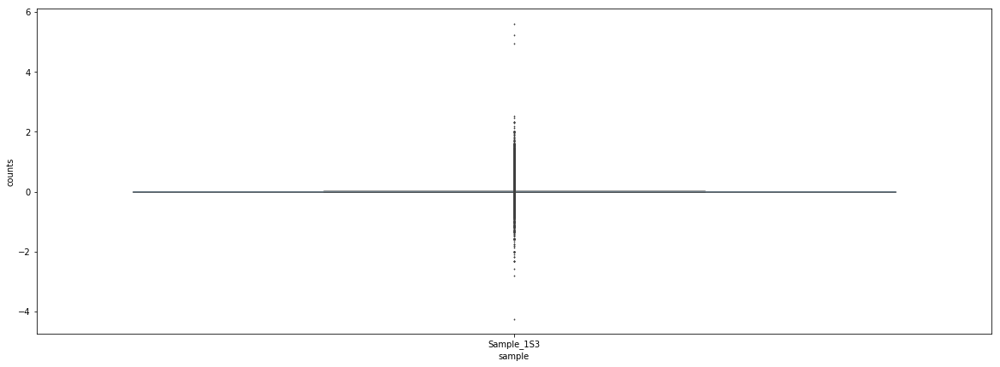

In [31]:
import seaborn as sns
fig,ax = plt.subplots(figsize=(20,7))
ax = sns.boxplot(x='sample',y='counts',data=stack[stack['sample']=='Sample_1S3'],fliersize=1,linewidth=0.5)

In [32]:
def embed_pdf_figure(width='640', height='480', title='Image'):
    data = BytesIO()
    plt.savefig(data, format='pdf', metadata={'Title': title})
    data = data.getvalue()
    data = 'data:application/pdf;base64,'+ str(b64encode(data), encoding='utf-8')
    display(HTML('<object width="{}" height="{}" data="{}" download="{}.pdf"></object>'.format(
        width, height, data, title)))
    plt.close()

In [33]:
import seaborn as sns
import matplotlib.pyplot as plt
from base64 import b64encode, b64decode
from io import StringIO, BytesIO
from IPython.core.display import HTML,Image
fig,ax = plt.subplots(figsize=(20,7))
ax = sns.boxplot(x='class',y='counts',data=stack,fliersize=0,linewidth=0.5)
embed_pdf_figure()

In [9]:
import pandas as pd
a = pd.DataFrame(data=[[2,3,7],[4,5,8]],columns=['a','b','c'],index=['c','d'])

In [15]:
import numpy as np
(np.log2(a))

,a,b,c
c,1.0,1.584963,2.807355
d,2.0,2.321928,3.000000


In [22]:
pd.DataFrame([[3],[4]])

,0
0,3
1,4


In [24]:
a - 3


,a,b,c
c,-1,0,4
d,1,2,5


In [26]:
a.iloc[0]=a.iloc[0]-3
a

,a,b,c
c,-1,0,4
d,4,5,8


In [37]:
a.apply(np.median,1).tolist()[1]

5.0

In [17]:
a - a.apply(np.median,1)

,a,b,c,d
c,NaN,NaN,4.0,NaN
d,NaN,NaN,5.0,NaN
